In [1]:
import pandas as pd
import numpy as np
import statsmodels.api as sm
import statsmodels.graphics.api as smg
from statsmodels.stats.outliers_influence import OLSInfluence
import matplotlib as mpl
import matplotlib.pyplot as plt
import seaborn as sns
import scipy
from scipy.stats import boxcox
from tqdm import tqdm
import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)

# Constructing Linear Models to Predict Beer Ratings on Observed Attributes
*Hayden Outlaw | Tulane MATH 6040 Linear Models | Spring 2024*

---------------
In 2022, New Orleans was one of the most competitive and dense cities for bars in the United States, with 56.3 bars, 1.4 breweries, and 4.3 wine bars per 100,000 residents [(via RealEstateWitch)](https://budgetbranders.com/blog/2020-drinking-statistics-and-habits-trends-you-can-expect-for-your-bar-business/). In the United States, as of 2022 there were 9,709 total registered breweries [(via Statista)](https://www.statista.com/topics/1654/beer-industry-in-the-united-states/#topicOverview) overall - given the large market size and variety of products, is there a way to identify individual product traits that can be used to regress total product quality?

Given a published dataset of consumer reviews from a variety of beers and breweries, I propose a linear model scheme to identify rated attributes that are indicative of overall beer quality with respect to consumer review score.

## Data Overview 📊

This project utilizes the [Beer Profile and Ratings Dataset](https://www.kaggle.com/datasets/ruthgn/beer-profile-and-ratings-data-set?resource=download), published on Kaggle in 2022. It contains consumer reviews, and tasting profiles from 934 different breweries across 3197 unique beers. The observed attributes are as follows, per published documentation:

- **Name:** Beer name *(string)*
- **Style:** Beer style *(string)*
- **Brewery:** Name of associated brewery *(string)*
- **Beer Name (Full):** The complete beer name (Brewery & Beer Name). Created to generate a unique identifier for each beer *(string)*
- **Description:** Any rater-generated notes on a beer if available *(string)*
- **ABV:** Alcohol content of beer as a percentage by volume *(float)*
- **Min IBU:** The minimum IBU value for each beer. IBU was not a collected value for each individual beer, but the range for each style was *(float)*
- **Max IBU:** The maximum IBU value for each beer. IBU was not a collected value for each individual beer, but the range for each stule was *(float)*

The following columns record tasting profiles for each beer, and are generated based on word counts, for each beer that has >25 reviews. The results were generated based on a clustering algorithm that segments specific adjectives into profile notes, and the resulting values are normalized word counts.

(Mouthfeel)
- **Astringency** *(float)*
- **Body** *(float)*
- **Alcohol** *(float)*

(Taste)
- **Bitter** *(float)*
- **Sweet** *(float)*
- **Sour** *(float)*
- **Salty** *(float)*

(Flavor/Aroma)
- **Fruits** *(float)*
- **Hoppy** *(float)*
- **Spices** *(float)*
- **Malty** *(float)*

The following columsn contain information from beer reviews, including the number of consumer reviews, the overall average rating score, and teh average ratings cores for the aroma, appearance, palate, and taste of each individual beer.

- **review_aroma** *(float)*
- **review_apperance** *(float)*
- **review_palate** *(float)*
- **review_overall** *(float)*
- **number_of_reviews** *(int)*



## Preliminary Analysis 🗃️
To examine the data, I load the dataset into the [pandas](https://pandas.pydata.org/) library, which provides dataframe objects and functionality to datasets. I also utilize the [numpy](https://numpy.org/), which is a standard array storage and manipulation library in Python, and inherited by pandas. I check for missing values, data typing, and create preliminary joint scatterplots for the observed data.

In [2]:
# loading data into memory
df = pd.read_csv('archive/beer_profile_and_ratings.csv')
df.head()

,Name,Style,Brewery,Beer Name (Full),Description,ABV,Min IBU,Max IBU,Astringency,Body,...,Fruits,Hoppy,Spices,Malty,review_aroma,review_appearance,review_palate,review_taste,review_overall,number_of_reviews
0,Amber,Altbier,Alaskan Brewing Co.,Alaskan Brewing Co. Alaskan Amber,"Notes:Richly malty and long on the palate, wit...",5.3,25,50,13,32,...,33,57,8,111,3.498994,3.636821,3.556338,3.643863,3.847082,497
1,Double Bag,Altbier,Long Trail Brewing Co.,Long Trail Brewing Co. Double Bag,"Notes:This malty, full-bodied double alt is al...",7.2,25,50,12,57,...,24,35,12,84,3.798337,3.846154,3.904366,4.024948,4.034304,481
2,Long Trail Ale,Altbier,Long Trail Brewing Co.,Long Trail Brewing Co. Long Trail Ale,Notes:Long Trail Ale is a full-bodied amber al...,5.0,25,50,14,37,...,10,54,4,62,3.409814,3.667109,3.600796,3.631300,3.830239,377
3,Doppelsticke,Altbier,Uerige Obergärige Hausbrauerei GmbH / Zum Uerige,Uerige Obergärige Hausbrauerei GmbH / Zum Ueri...,Notes:,8.5,25,50,13,55,...,49,40,16,119,4.148098,4.033967,4.150815,4.205163,4.005435,368
4,Sleigh'r Dark Doüble Alt Ale,Altbier,Ninkasi Brewing Company,Ninkasi Brewing Company Sleigh'r Dark Doüble A...,Notes:Called 'Dark Double Alt' on the label.Se...,7.2,25,50,25,51,...,11,51,20,95,3.625000,3.973958,3.734375,3.765625,3.817708,96


Missing data is represented in pandas as a [np.NaN] object. I can check for missing data in each column by getting the sum of the [pandas isna()](https://pandas.pydata.org/pandas-docs/stable/reference/api/pandas.DataFrame.isna.html) method.

In [3]:
print(df.isna().sum())

Name                 0
Style                0
Brewery              0
Beer Name (Full)     0
Description          0
ABV                  0
Min IBU              0
Max IBU              0
Astringency          0
Body                 0
Alcohol              0
Bitter               0
Sweet                0
Sour                 0
Salty                0
Fruits               0
Hoppy                0
Spices               0
Malty                0
review_aroma         0
review_appearance    0
review_palate        0
review_taste         0
review_overall       0
number_of_reviews    0
dtype: int64


There does not seem to be any missing values within the dataset, nor any non NaN object placeholders for missing data.

Next, I check for the actual data types that are loaded into memory using the [pandas dtypes](https://pandas.pydata.org/pandas-docs/stable/reference/api/pandas.DataFrame.dtypes.html) attribute. The library will do its best to guess the appropriate data type for each column, but it is important to check for errors (unordered categories stored as integers, precision loss, etc.,).

In [4]:
df.dtypes

Name                  object
Style                 object
Brewery               object
Beer Name (Full)      object
Description           object
ABV                  float64
Min IBU                int64
Max IBU                int64
Astringency            int64
Body                   int64
Alcohol                int64
Bitter                 int64
Sweet                  int64
Sour                   int64
Salty                  int64
Fruits                 int64
Hoppy                  int64
Spices                 int64
Malty                  int64
review_aroma         float64
review_appearance    float64
review_palate        float64
review_taste         float64
review_overall       float64
number_of_reviews      int64
dtype: object

Everything seems to be loaded appropriately. Note that the 'object' attribute is assigned to strings - it is the default for data that is non-quantitative, and unordered. Ordered categorical data can be stored as a 'category'.

I also do not have to worry about indexing the data. While the data was provided with the "Beer Name (Full)" attribute that provides a unique identifier string, since the data are unique, pandas will provide a built-in integer index into the dataframe, which can be later used to match entities across different copies of the data created in memory.

For modeling purposes, I want to extract only the quantitative attributes. I can do this by creating a copy of the dataframe by dropping the columns related to 'object' data types along the column axis.

In [5]:
# creating quantitative copy of dataframe
df_quant = df.drop(['Name', 'Style', 'Brewery', 'Beer Name (Full)', 'Description'], axis = 1)
df_quant.head()

,ABV,Min IBU,Max IBU,Astringency,Body,Alcohol,Bitter,Sweet,Sour,Salty,Fruits,Hoppy,Spices,Malty,review_aroma,review_appearance,review_palate,review_taste,review_overall,number_of_reviews
0,5.3,25,50,13,32,9,47,74,33,0,33,57,8,111,3.498994,3.636821,3.556338,3.643863,3.847082,497
1,7.2,25,50,12,57,18,33,55,16,0,24,35,12,84,3.798337,3.846154,3.904366,4.024948,4.034304,481
2,5.0,25,50,14,37,6,42,43,11,0,10,54,4,62,3.409814,3.667109,3.600796,3.631300,3.830239,377
3,8.5,25,50,13,55,31,47,101,18,1,49,40,16,119,4.148098,4.033967,4.150815,4.205163,4.005435,368
4,7.2,25,50,25,51,26,44,45,9,1,11,51,20,95,3.625000,3.973958,3.734375,3.765625,3.817708,96


Now that we have the data loaded, I create a box-and-whisker plot for the distributions in each column, to see how the data is spread independent of any interactions.

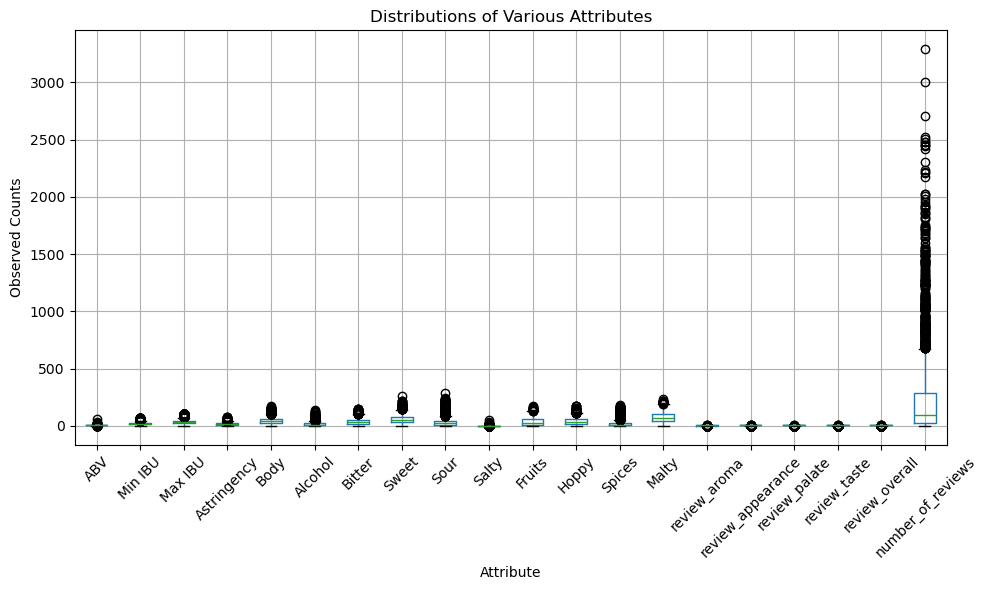

In [6]:
plt.figure(figsize = (10,6))
boxplot = df_quant.boxplot()
plt.xticks(rotation=45)

plt.title("Distributions of Various Attributes")
plt.xlabel("Attribute")
plt.ylabel("Observed Counts")
plt.tight_layout()

plt.show()

Clearly the number of reviews for a given beer will vary much more than a rating on a finite scale. If I drop the `total_number_of_reviews` attribute, it might be possible to get a better look.

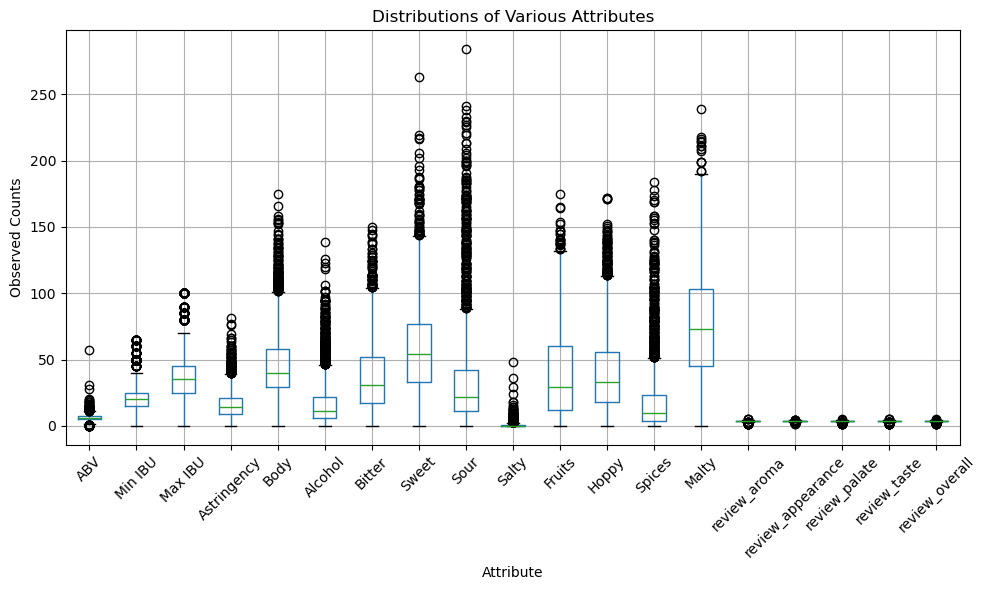

In [7]:
plt.figure(figsize = (10,6))
boxplot = df_quant.drop(["number_of_reviews"], axis = 1).boxplot()
plt.xticks(rotation=45)

plt.title("Distributions of Various Attributes")
plt.xlabel("Attribute")
plt.ylabel("Observed Counts")
plt.tight_layout()

plt.show()

The last five attributes are on a fixed scale from 1-5, which inherently restricts their distributions. ABV is distributed on its own - it can't exceed 100%, and the min/max IBU attributes also are distributed together and are related by their shared mechanism. The flavor attributes are the most interesting - since they are all generated by the same process (recall, as a mechanism of a clustering algorithm based on word counts), they are more directly comparable. For instance, there were a much greater number of beers with a higher `sour`, `malty`, or `sweet` attributes as opposed to `astringency`, `fruits`, or `salty`. However, since they are floored at 0, they are generally very asymmetric distributions, with low medians but proportionately long tails.

Now, I want to examine how these attributes interact with each other. I can do this using the [seaborn](https://seaborn.pydata.org/) library, which contains advanced visualization methods such as the [pairplot](https://seaborn.pydata.org/generated/seaborn.pairplot.html) function. Note that the plot will be very large, given that there are 19 quantitative covariates in our dataset.

<Figure size 1000x1000 with 0 Axes>

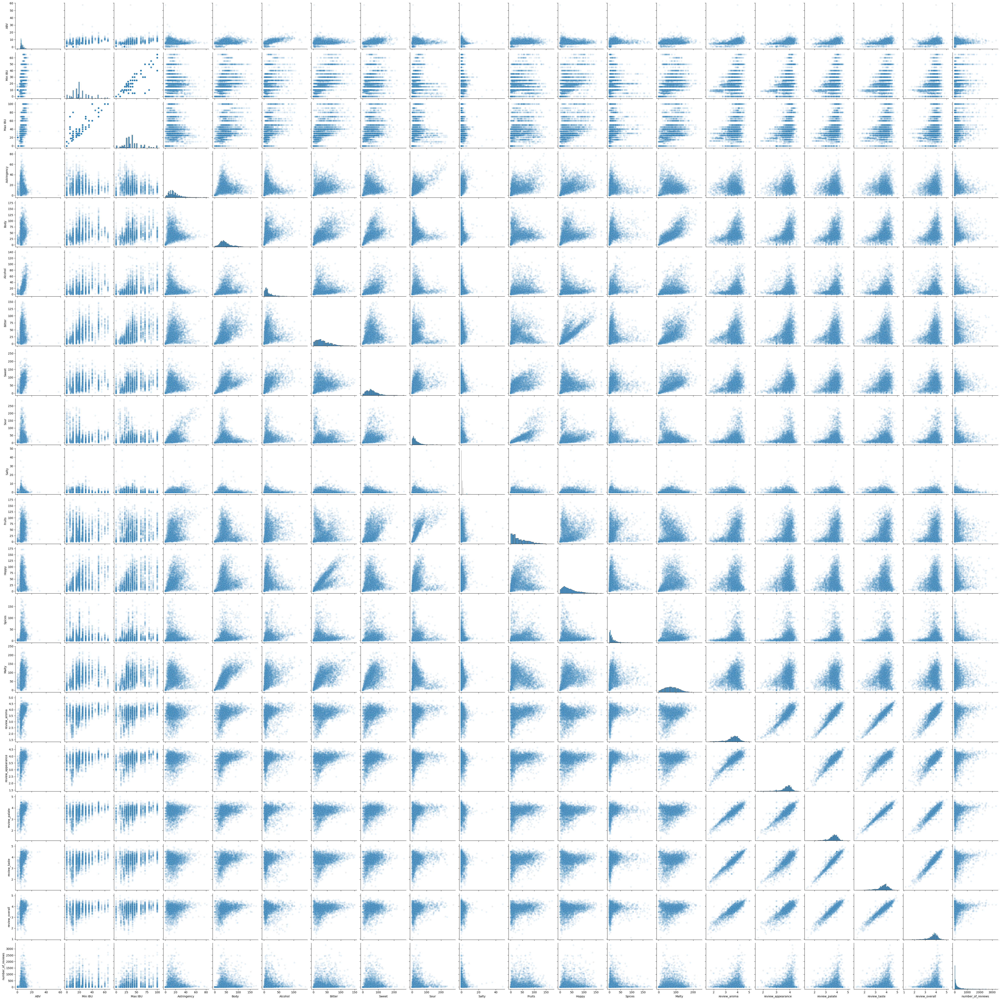

In [8]:
plt.figure(figsize = (10,10))
warnings.simplefilter(action='ignore', category=FutureWarning)
sns.pairplot(data = df_quant, kind = "scatter", plot_kws=dict(alpha=0.1))

There are a few interesting things to note from this figure. The default plots for the diagonal values are distribution histograms, which give us a good idea of the center and skew of each of these attributes. Most of these confirm the intuition from the box-plots, and the tails are more easily visible as a histogram.

The Min IBU and Max IBU attributes show striping, which indicate they are not continuously valued. Recall from the documentation that the individual values for each observation were not available, only the range of values for a given Beer Type - which manifests as only a finite set of discrete options for a given datum.

Certain attributes show better signs of collinearity than others. Bitter and Hoppy, and Fruits and Sour particularly show a strong linear relationship empirically. Of more concerning note is the clearly autocorrelated group of observations in the lower right corner, corresponding to the different quantitative reviews along each attribute, and then the final rating. 

## Preliminary Linear Model 🎰
[TODO]

In [9]:
# splitting into X and Y
X = df_quant.drop(['review_overall'], axis = 1)
y = df_quant[['review_overall']]

print(X.shape)
print(y.shape)

print(X.columns)

(3197, 19)
(3197, 1)
Index(['ABV', 'Min IBU', 'Max IBU', 'Astringency', 'Body', 'Alcohol', 'Bitter',
       'Sweet', 'Sour', 'Salty', 'Fruits', 'Hoppy', 'Spices', 'Malty',
       'review_aroma', 'review_appearance', 'review_palate', 'review_taste',
       'number_of_reviews'],
      dtype='object')


In [10]:
# fitting model
mod = sm.OLS(y, X)
beermod = mod.fit()
print(beermod.summary())

                                 OLS Regression Results                                
Dep. Variable:         review_overall   R-squared (uncentered):                   0.999
Model:                            OLS   Adj. R-squared (uncentered):              0.999
Method:                 Least Squares   F-statistic:                          1.297e+05
Date:                Thu, 02 May 2024   Prob (F-statistic):                        0.00
Time:                        15:01:36   Log-Likelihood:                          1855.4
No. Observations:                3197   AIC:                                     -3673.
Df Residuals:                    3178   BIC:                                     -3558.
Df Model:                          19                                                  
Covariance Type:            nonrobust                                                  
                        coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------

While this model does indeed have a reported R-squared value of $0.99$, it has serious flaws. Of most important note is the condition number, which is $4.39 * 10^3$ - indicating that there are highly autocorrelated attributes and that the problem is ill-conditioned. This can also be observed throuh a variety of other symptoms, most notably the variety of fit coefficient values in the data. The `review` attributes have values $>0.1$, but none of the others do - recalling the preliminary joint plot, it is likely that they are the cause of the poor result.

## Improving the OLS Model 🥽

In [11]:
# creating scaled dataframe
Xe = (X - X.mean()) / (X.std())
Xe.head()

,ABV,Min IBU,Max IBU,Astringency,Body,Alcohol,Bitter,Sweet,Sour,Salty,Fruits,Hoppy,Spices,Malty,review_aroma,review_appearance,review_palate,review_taste,number_of_reviews
0,-0.481621,0.288434,0.51571,-0.337711,-0.544535,-0.464822,0.412374,0.458825,-0.004065,-0.476967,-0.171212,0.528732,-0.435485,0.893752,-0.277807,-0.291442,-0.231343,-0.114885,0.728873
1,0.264355,0.288434,0.51571,-0.433766,0.418937,0.054468,-0.130448,-0.095413,-0.479189,-0.476967,-0.449878,-0.194865,-0.267111,0.217219,0.317061,0.227459,0.542161,0.631812,0.684652
2,-0.599407,0.288434,0.51571,-0.241656,-0.351840,-0.637919,0.218509,-0.445458,-0.618931,-0.476967,-0.883360,0.430060,-0.603859,-0.334030,-0.455029,-0.216363,-0.132534,-0.139501,0.397209
3,0.774760,0.288434,0.51571,-0.337711,0.341859,0.804555,0.412374,1.246426,-0.423292,-0.008067,0.324196,-0.030411,-0.098736,1.094207,1.012122,0.693016,1.089901,0.984925,0.372335
4,0.264355,0.288434,0.51571,0.814953,0.187704,0.516060,0.296055,-0.387117,-0.674828,-0.008067,-0.852397,0.331387,0.069638,0.492844,-0.027402,0.544264,0.164350,0.123695,-0.379437


<Axes: >

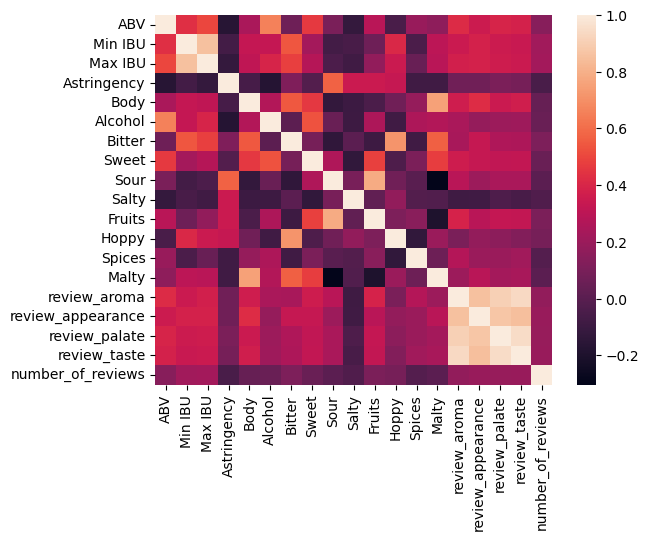

In [12]:
sns.heatmap(Xe.corr())

<Figure size 1000x1000 with 0 Axes>

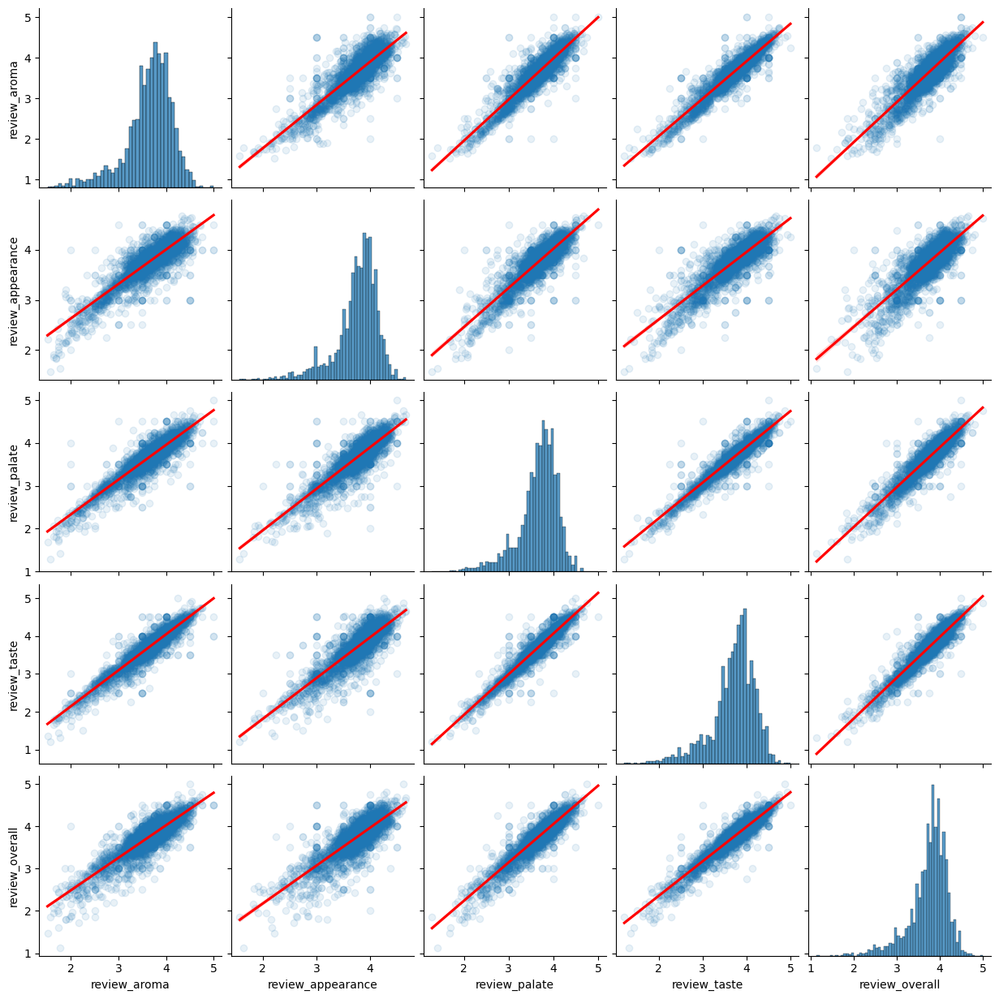

In [13]:
df_ratings = df[['review_aroma', 'review_appearance', 'review_palate', 'review_taste', 'review_overall']]
plt.figure(figsize = (10,10))
warnings.simplefilter(action='ignore', category=FutureWarning)
sns.pairplot(data = df_ratings, kind = "reg", plot_kws={'line_kws':{'color':'red'}, 'scatter_kws': {'alpha': 0.1}})

In [14]:
df_attributes = X[['ABV', 'Min IBU', 'Max IBU', 'Astringency', 'Body', 'Alcohol', 'Bitter',
       'Sweet', 'Sour', 'Salty', 'Fruits', 'Hoppy', 'Spices', 'Malty']]

High R-squared of 0.999. However, the condition number is 4e+03, which indicates that there are strong multicollinearity between some of the variables. 

In [15]:
# trying without other reviews
mod = sm.OLS(y, df_attributes).fit()
print(mod.summary())

                                 OLS Regression Results                                
Dep. Variable:         review_overall   R-squared (uncentered):                   0.953
Model:                            OLS   Adj. R-squared (uncentered):              0.952
Method:                 Least Squares   F-statistic:                              4569.
Date:                Thu, 02 May 2024   Prob (F-statistic):                        0.00
Time:                        15:01:40   Log-Likelihood:                         -3908.3
No. Observations:                3197   AIC:                                      7845.
Df Residuals:                    3183   BIC:                                      7930.
Df Model:                          14                                                  
Covariance Type:            nonrobust                                                  
                  coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------

R squared went down to 0.95, but condition number dropped to 77.4. However, this probably is still undesireable due to the asymmetrical and skewed nature of most of the attributes. Consider the observed [Jarque-Bera](https://en.wikipedia.org/wiki/Jarque%E2%80%93Bera_test), a function of skew and kurtosis that evaluates the likelihood that the linear model is fit to normally distributed data. This model has a value of 59328.981, which is too high for the underlying assumptions about linear models to hold.

In [16]:
df_attributes = df_attributes + 1
df_attributes.head()



,ABV,Min IBU,Max IBU,Astringency,Body,Alcohol,Bitter,Sweet,Sour,Salty,Fruits,Hoppy,Spices,Malty
0,6.3,26,51,14,33,10,48,75,34,1,34,58,9,112
1,8.2,26,51,13,58,19,34,56,17,1,25,36,13,85
2,6.0,26,51,15,38,7,43,44,12,1,11,55,5,63
3,9.5,26,51,14,56,32,48,102,19,2,50,41,17,120
4,8.2,26,51,26,52,27,45,46,10,2,12,52,21,96


In [17]:
df_attributes_bc = df_attributes.copy() + 1
y_bc = y.copy() + 1
for col in df_attributes.columns:
    df_attributes_bc[col], lamb = boxcox(df_attributes[col])
    print("Column %s: Lambda = %f" %(col, lamb))

df_attributes_bc.drop(["Min IBU"], axis = 1, inplace = True)

y_bc["review_overall"], lamb= boxcox(y["review_overall"])

df_attributes_bc.head()

Column ABV: Lambda = 0.420578
Column Min IBU: Lambda = 0.537548
Column Max IBU: Lambda = 0.589463
Column Astringency: Lambda = 0.360645
Column Body: Lambda = 0.453429
Column Alcohol: Lambda = 0.049046
Column Bitter: Lambda = 0.398046
Column Sweet: Lambda = 0.512819
Column Sour: Lambda = 0.103424
Column Salty: Lambda = -1.352472
Column Fruits: Lambda = 0.292763
Column Hoppy: Lambda = 0.335624
Column Spices: Lambda = 0.033498
Column Malty: Lambda = 0.667288


,ABV,Max IBU,Astringency,Body,Alcohol,Bitter,Sweet,Sour,Salty,Fruits,Hoppy,Spices,Malty
0,2.778622,15.52592,4.409523,8.559959,2.437638,9.217199,15.898542,4.255269,0.000000,6.174833,8.661625,2.280106,33.423880
1,3.383126,15.52592,4.220105,11.696682,3.167659,7.712793,13.415253,3.292009,0.000000,5.349208,6.939742,2.678365,27.552634
2,2.673893,15.52592,4.590475,9.271114,2.041793,8.714700,11.627801,2.833423,0.000000,3.476582,8.455961,1.653613,22.289779
3,3.750934,15.52592,4.409523,11.477230,3.777710,9.217199,18.947005,3.441965,0.449828,7.321180,7.382296,2.972015,35.069228
4,3.383126,15.52592,6.206092,11.025095,3.577169,8.919714,11.940871,2.599882,0.449828,3.654410,8.242701,3.205186,30.010231


In [18]:
y_bc.head()

,review_overall
0,45.839775
1,55.074407
2,45.069071
3,53.568348
4,44.501892


<Figure size 1000x1000 with 0 Axes>

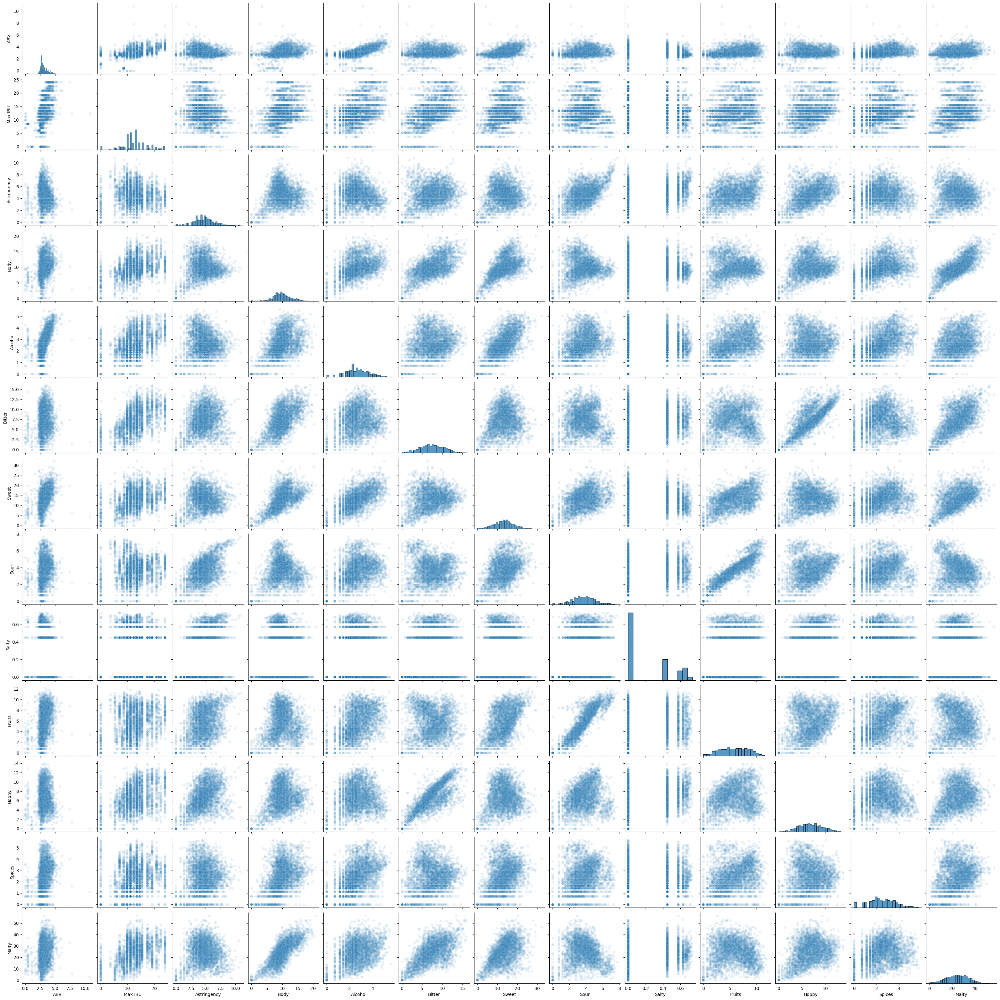

In [19]:
plt.figure(figsize = (10,10))
warnings.simplefilter(action='ignore', category=FutureWarning)
sns.pairplot(data = df_attributes_bc, kind = "scatter", plot_kws=dict(alpha=0.1))

In [20]:
mod = sm.OLS(y_bc, df_attributes_bc).fit()
print(mod.summary())

                                 OLS Regression Results                                
Dep. Variable:         review_overall   R-squared (uncentered):                   0.908
Model:                            OLS   Adj. R-squared (uncentered):              0.908
Method:                 Least Squares   F-statistic:                              2431.
Date:                Thu, 02 May 2024   Prob (F-statistic):                        0.00
Time:                        15:01:54   Log-Likelihood:                         -13048.
No. Observations:                3197   AIC:                                  2.612e+04
Df Residuals:                    3184   BIC:                                  2.620e+04
Df Model:                          13                                                  
Covariance Type:            nonrobust                                                  
                  coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------

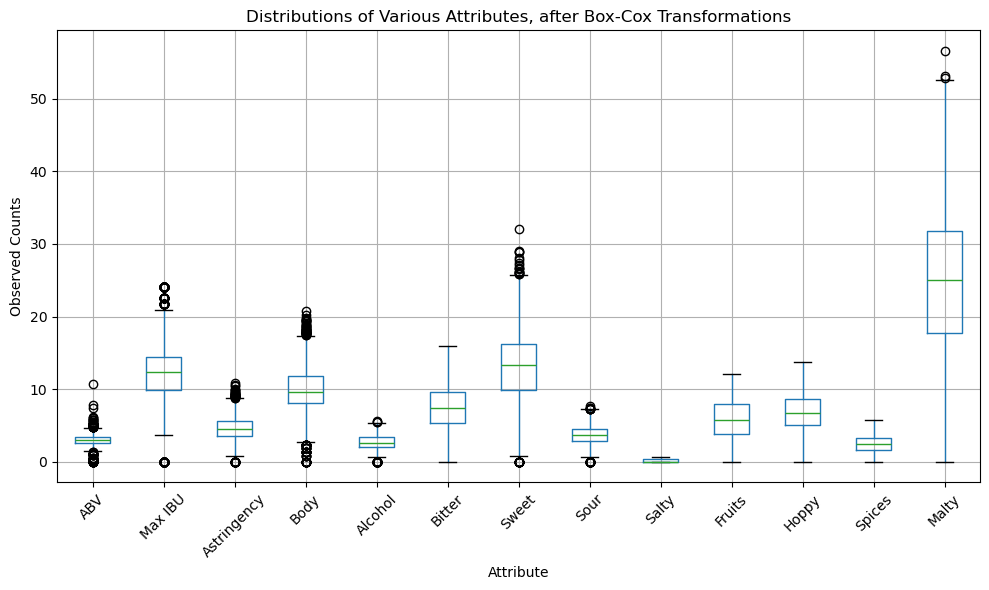

In [21]:
plt.figure(figsize = (10,6))
boxplot = df_attributes_bc.boxplot()
plt.xticks(rotation=45)

plt.title("Distributions of Various Attributes, after Box-Cox Transformations")
plt.xlabel("Attribute")
plt.ylabel("Observed Counts")
plt.tight_layout()

plt.show()

In [22]:
df_a_bc_dropped = df_attributes_bc.drop(["Salty", "Malty"], axis = 1)
mod = sm.OLS(y_bc, df_a_bc_dropped).fit()
print(mod.summary())

                                 OLS Regression Results                                
Dep. Variable:         review_overall   R-squared (uncentered):                   0.908
Model:                            OLS   Adj. R-squared (uncentered):              0.908
Method:                 Least Squares   F-statistic:                              2872.
Date:                Thu, 02 May 2024   Prob (F-statistic):                        0.00
Time:                        15:01:55   Log-Likelihood:                         -13049.
No. Observations:                3197   AIC:                                  2.612e+04
Df Residuals:                    3186   BIC:                                  2.619e+04
Df Model:                          11                                                  
Covariance Type:            nonrobust                                                  
                  coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------

In [27]:
influence = mod.get_influence()

In [28]:
# Get the influence summary table as a Pandas DataFrame
summary_table = influence.summary_table()

# Convert the summary table to a DataFrame
influence_table = pd.DataFrame(summary_table)

# Remove the first row and first two columns (headers and row indices)
influence_table = influence_table.iloc[2:, 1:]
influence_table.columns = ["endog", "fitted value", "cooks d", "student residual", "hat diag", "diffits internal", "ext.student residual", "diffits"]
influence_table["fitted value"], influence_table["student residual"] = influence_table["fitted value"].astype(str).astype(float), influence_table["student residual"].astype(str).astype(float)

influence_table.head()


,endog,fitted value,cooks d,student residual,hat diag,diffits internal,ext.student residual,diffits
2,45.83977454361331,40.997563,1.9827382982863466e-05,0.337512,0.0019109504556397662,0.01476825016078405,0.3374648693371603,0.01476619628218985
3,55.074407225212674,46.016893,2.8716701217528244e-05,0.630973,0.0007927944485709501,0.017773117717294586,0.6309138556048343,0.01777143865376183
4,45.06907140726802,39.187587,1.9397112330121788e-05,0.409819,0.0012688007018434547,0.014607129616435247,0.40976585470754523,0.014605222009940078
5,53.56834843107224,46.360545,3.981419019080386e-05,0.502353,0.0017324430410123504,0.02092740050983023,0.5022943756758037,0.020924944712113206
6,44.501891931089844,43.675071,6.825732027329825e-07,0.057641,0.0022547493739065814,0.0027401286885952655,0.05763200327672733,0.002739700056907431


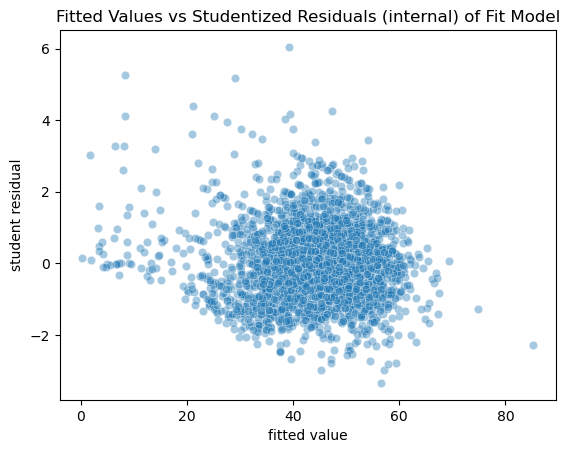

In [29]:
sns.scatterplot(data = influence_table, x = "fitted value", y = "student residual", alpha = 0.4)
plt.title("Fitted Values vs Studentized Residuals (internal) of Fit Model")
plt.show()

Text(0.5, 1.0, 'Barplot of Fitted β Values')

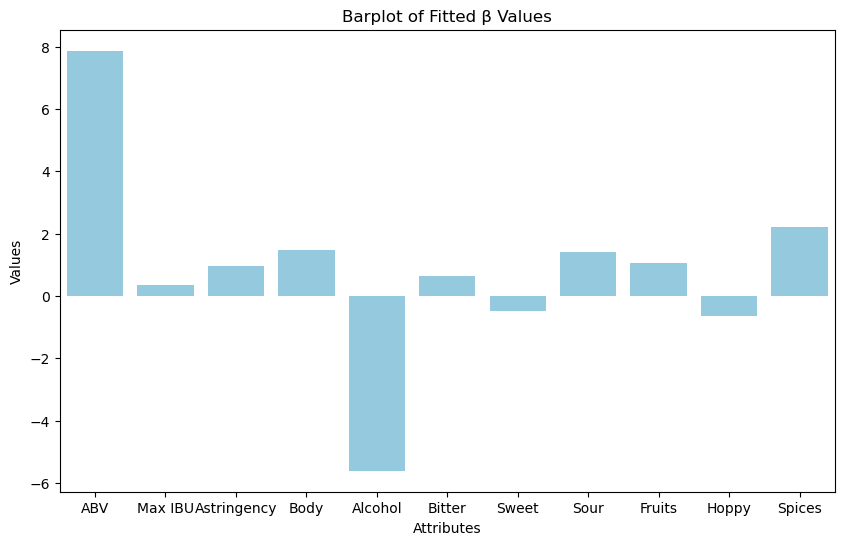

In [30]:
betas= pd.Series(mod.params)
betas_df = pd.DataFrame({'Attributes': betas.index, "Values": betas.values})
plt.figure(figsize=(10, 6))
sns.barplot(data = betas_df, x = "Attributes", y = "Values", color = "skyblue")
plt.title("Barplot of Fitted β Values")